In [13]:

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.offline as py
import plotly.graph_objs as go
import plotly_express as px 

In [15]:
df = pd.read_csv("https://tamucc-ir.tdl.org/bitstream/handle/1969.6/87766/NuecesBay_RawDataOnly.csv?sequence=1&isAllowed=y", parse_dates=['#date+time'])

In [16]:
df.shape

(871680, 2)

In [19]:
df

,datetime,185-pwl
0,2010-01-21 00:00:00+00:00,-0.326
1,2010-01-21 00:06:00+00:00,-0.322
2,2010-01-21 00:12:00+00:00,-0.322
3,2010-01-21 00:18:00+00:00,-0.317
4,2010-01-21 00:24:00+00:00,-0.320
...,...,...
871675,2019-12-31 23:30:00+00:00,7.550
871676,2019-12-31 23:36:00+00:00,7.546
871677,2019-12-31 23:42:00+00:00,7.542
871678,2019-12-31 23:48:00+00:00,7.543


In [17]:
total = len(df)
missing = df.isnull().sum()
print ('The total number of values = ',total,'\n','The number of missing values are','\n',missing)
print('\n')
print('The Percentage of missing values in each column is', '\n' ,missing/total * 100)

The total number of values =  871680 
 The number of missing values are 
 #date+time        0
185-pwl       18605
dtype: int64


The Percentage of missing values in each column is 
 #date+time    0.000000
185-pwl       2.134384
dtype: float64


In [20]:
df = df.rename(columns={'#date+time': 'datetime', '185-pwl': 'waterlevel'})
df[['waterlevel']] = df[['waterlevel']].fillna(method='ffill')
df

,datetime,waterlevel
0,2010-01-21 00:00:00+00:00,-0.326
1,2010-01-21 00:06:00+00:00,-0.322
2,2010-01-21 00:12:00+00:00,-0.322
3,2010-01-21 00:18:00+00:00,-0.317
4,2010-01-21 00:24:00+00:00,-0.320
...,...,...
871675,2019-12-31 23:30:00+00:00,7.550
871676,2019-12-31 23:36:00+00:00,7.546
871677,2019-12-31 23:42:00+00:00,7.542
871678,2019-12-31 23:48:00+00:00,7.543


In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 871680 entries, 0 to 871679
Data columns (total 2 columns):
 #   Column      Non-Null Count   Dtype              
---  ------      --------------   -----              
 0   datetime    871680 non-null  datetime64[ns, UTC]
 1   waterlevel  871680 non-null  float64            
dtypes: datetime64[ns, UTC](1), float64(1)
memory usage: 13.3 MB


**Plotting datetime vs waterlevel data interactive plot**

Using Plotly Express gives as ability for interactive plots which makes visualization of large data worth because here we can zoom in/out, hover on data which just makes it more interactive overall. I tried using both seaborn and plotly as you can see and I am going with plotly for rest of plots until needed for some changes

In [23]:
df = df.set_index('datetime')
df

,waterlevel
datetime,
2010-01-21 00:00:00+00:00,-0.326
2010-01-21 00:06:00+00:00,-0.322
2010-01-21 00:12:00+00:00,-0.322
2010-01-21 00:18:00+00:00,-0.317
2010-01-21 00:24:00+00:00,-0.320
...,...
2019-12-31 23:30:00+00:00,7.550
2019-12-31 23:36:00+00:00,7.546
2019-12-31 23:42:00+00:00,7.542


In [24]:
df["Year"] = df.index.year
df["Month"] = df.index.month
df["Weekday"] = df.index.dayofweek

In [25]:
df

,waterlevel,Year,Month,Weekday
datetime,,,,
2010-01-21 00:00:00+00:00,-0.326,2010,1,3
2010-01-21 00:06:00+00:00,-0.322,2010,1,3
2010-01-21 00:12:00+00:00,-0.322,2010,1,3
2010-01-21 00:18:00+00:00,-0.317,2010,1,3
2010-01-21 00:24:00+00:00,-0.320,2010,1,3
...,...,...,...,...
2019-12-31 23:30:00+00:00,7.550,2019,12,1
2019-12-31 23:36:00+00:00,7.546,2019,12,1
2019-12-31 23:42:00+00:00,7.542,2019,12,1


Plotting datetime vs waterlevel data interactive plot

Using Plotly Express gives as ability for interactive plots which makes visualization of large data worth because here we can zoom in/out, hover on data which just makes it more interactive overall. I tried using both seaborn and plotly as you can see and I am going with plotly for rest of plots until needed for some changes


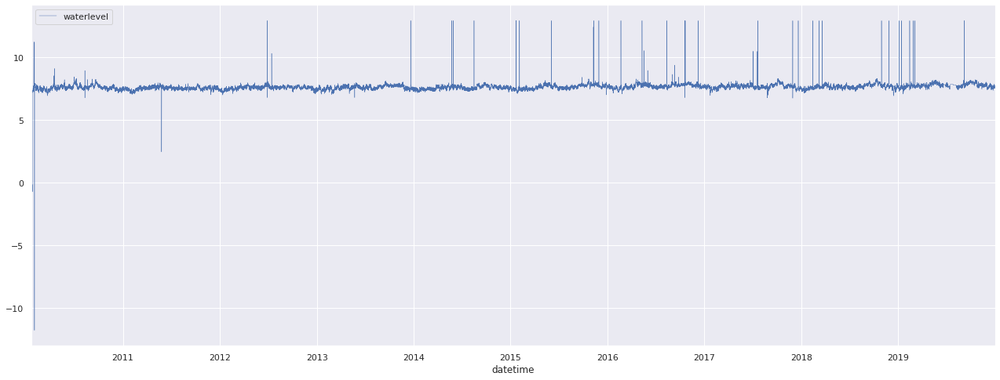

In [26]:
sns.set(rc={'figure.figsize':(22, 8)})
df[["waterlevel"]].plot(linewidth = 0.45)

In [27]:
fig = px.line(df, x=df.index, y="waterlevel", title='Generic time series plot of water level')
fig.show()